In [1]:
import os
import shutil
import h5py
import numpy as np
from astropy.nddata.utils import Cutout2D
from astropy.io import fits
from astropy.table import Table
import pandas as pd
import matplotlib.pyplot as plt
from astropy.visualization import (ZScaleInterval, ImageNormalize)
import tensorflow as tf
from tensorflow import keras
from sklearn.utils import shuffle
import umap
from sklearn.preprocessing import StandardScaler
from astropy.wcs import WCS,utils
#%load_ext autoreload
#from functions import *
#from create_models import *

In [5]:
cats_dir = os.path.expandvars('$SCRATCH') + '/catalogues/'

In [6]:
cats=os.listdir(cats_dir)
len(cats)

15429

In [6]:
#importing images

## Color Images

In [7]:
import csv
with open ('arcs_list.csv', 'r') as f:
    arcs = [row[0] for row in csv.reader(f,delimiter='\t')]
arc_tiles= []

for tile in arcs:
    if '~' not in tile.split(' '):
        arc_tiles.append(tile.split(' ')[0][:-2])
arc_dir = os.path.expandvars("$SCRATCH") + "/" + 'all_cand/'
all_cand = os.listdir(arc_dir)
cand_64 = []
for i in all_cand:
    if 'cutout' in i.split('_'):
        cand_64.append(i)
arc_tiles = list(set(list(arc_tiles))) #remove duplicates if any
to_remove = ['254.243', '225.272', '081.185','229.297', '012.180']
[arc_tiles.remove(i) for i in to_remove]
index_dict = {k:v for v,k in enumerate(arc_tiles)}
inv_dict = {v: k for k, v in index_dict.items()}

In [15]:
def get_img(tile):    
    u_cut = 'CFIS.' + tile + '.u_cutout_0.fits' 
    r_cut = 'CFIS.' + tile + '.r_cutout_0.fits' 
    if u_cut in all_cand:
        img_u = fits.open(arc_dir + u_cut, memmap=True)[0].data
    else:
        img_u = np.random.normal(loc = 0.5,scale= 0.13, size=(64,64))

    if r_cut in all_cand:
        img_r = fits.open(arc_dir + r_cut, memmap=True)[0].data    
    else:
        np.random.normal(loc = 0.5,scale= 0.13, size=(64,64))

    return np.stack((img_u, img_r), axis = 2)

In [16]:
#img = get_img('230.247')
#img = get_img('036.242')
#img = get_img('417.250')
#img = get_img('274.262')
img = get_img('182.277')
img = get_img('411.247')
img = get_img('304.241')

In [17]:
from astropy.visualization import (ZScaleInterval, ImageNormalize, MinMaxInterval, SqrtStretch, SinhStretch)
from astropy.visualization import make_lupton_rgb
from astropy.visualization import simple_norm

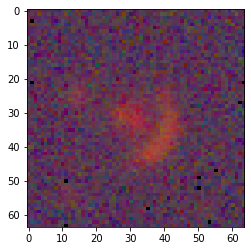

In [23]:
cutout = img
cutout_r = cutout[:,:,1] #r
cutout_g = np.random.normal(loc = 0.5,scale= 0.13, size=(64,64))
cutout_b = cutout[:,:,0] #u

# Create interval object
interval = MinMaxInterval()
#norms
vmin, vmax = interval.get_limits(cutout_r)
norm_r = ImageNormalize(cutout_r, stretch = SqrtStretch(),interval= ZScaleInterval())
vmin, vmax = interval.get_limits(cutout_g)
norm_g = ImageNormalize(cutout_g, stretch = SqrtStretch(), interval= ZScaleInterval())
vmin, vmax = interval.get_limits(cutout_b)
norm_b = ImageNormalize(cutout_b, stretch = SqrtStretch(), interval= ZScaleInterval())

#switched blue and green to get more yellow-orange image
cutout_rgb = make_lupton_rgb(norm_r(cutout_r), norm_b(cutout_b), norm_g(cutout_g), stretch = 0.75, minimum= [0.05,0.35,0.25])

plt.imshow(cutout_rgb)


In [184]:
hdu_r = fits.PrimaryHDU(cutout_r)
r_name = 'r_cut.fits'
hdu_r.writeto(r_name)
hdu_g = fits.PrimaryHDU(cutout_g)
g_name = 'g_cut.fits'
hdu_g.writeto(g_name)
hdu_b = fits.PrimaryHDU(cutout_b)
b_name = 'b_cut.fits'
hdu_b.writeto(b_name)

INFO: Red: [aplpy.rgb]
INFO: vmin = -4.930e+00 (auto) [aplpy.rgb]
INFO: vmax =  3.146e+01 (auto) [aplpy.rgb]
INFO: Green: [aplpy.rgb]
INFO: vmin =  1.292e-01 (auto) [aplpy.rgb]
INFO: vmax =  8.743e-01 (auto) [aplpy.rgb]
INFO: Blue: [aplpy.rgb]
INFO: vmin = -7.768e+00 (auto) [aplpy.rgb]
INFO: vmax =  1.287e+01 (auto) [aplpy.rgb]
exeption


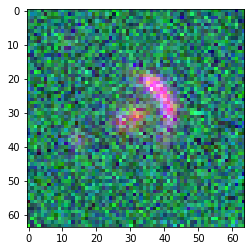

In [185]:
import aplpy
import matplotlib.image as im
from skimage.util import img_as_float
img_rgb = [r_name, g_name, b_name]

try:
    aplpy.make_rgb_image( img_rgb, output ='rgb_img.png')
except:
    print('exeption')
    img = im.imread('rgb_img.png')
    plt.imshow(img)
    

INFO: Red: [aplpy.rgb]
INFO: vmin = -4.930e+00 (auto) [aplpy.rgb]
INFO: vmax =  3.146e+01 (auto) [aplpy.rgb]
INFO: Green: [aplpy.rgb]
INFO: vmin = -4.930e+00 (auto) [aplpy.rgb]
INFO: vmax =  3.146e+01 (auto) [aplpy.rgb]
INFO: Blue: [aplpy.rgb]
INFO: vmin =  1.000e+00 [aplpy.rgb]
INFO: vmax =  1.287e+01 (auto) [aplpy.rgb]
exeption


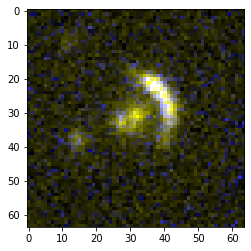

In [186]:
img_rgb = [r_name, r_name, b_name]

try:
    aplpy.make_rgb_image( img_rgb, output ='rgb_img.png',vmin_b=1)
except:
    print('exeption')
    img = im.imread('rgb_img.png')
    plt.imshow(img)

----------

In [8]:
import csv

# open the file in the write mode
f = open('eval_tiles.list', 'w', newline='')

# create the csv writer
writer = csv.writer(f)

# write a row to the csv file
writer.writerow(cats)

# close the file
f.close()

In [10]:
with open ('eval_tiles.list', 'r') as f:
    new_cat = [row for row in csv.reader(f,delimiter=',')]
new_cat = new_cat[0]

In [13]:
scratch = os.path.expandvars('$SCRATCH') + '/catalogues/'
name = os.listdir(scratch)[0]
init = pd.read_csv(scratch  + name)
keys = list(init.keys()) + ['tile']
potential_lenses = pd.DataFrame({k:[] for v,k in enumerate(keys)})

In [14]:
import warnings
warnings.filterwarnings('ignore')
threshold= 0.067795
for i in range(len(new_cat)):
    df = pd.read_csv(cats_dir + new_cat[i])
    df.drop(df.index[df['pred'] == 2], inplace = True)
    new_rows = (df[df['pred'] > threshold])
    new_rows['tile'] = new_cat[i]
    potential_lenses= potential_lenses.append(new_rows)

In [16]:
potential_lenses.to_csv('potential_lenses_classifier.csv')

In [17]:
potential_lenses = pd.read_csv('potential_lenses_classifier.csv')

(array([3228.,  893.,  406.,  220.,  150.,   76.,   51.,   20.,   13.,
          17.]),
 array([0.06780314, 0.11101435, 0.15422555, 0.19743676, 0.24064796,
        0.28385916, 0.32707037, 0.37028157, 0.41349277, 0.45670398,
        0.49991518]),
 <BarContainer object of 10 artists>)

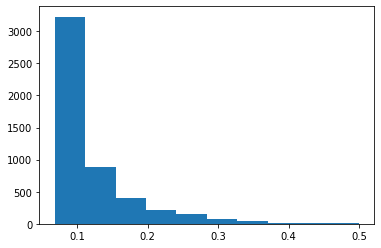

In [18]:
plt.hist(potential_lenses['pred'])

In [19]:
new_lens_tiles = os.path.expandvars('$SCRATCH') + '/found_lenses'
new_lens_cuts = new_lens_tiles +'/cutouts'
cutout_size = 64

image_dir = "/home/anahoban/projects/rrg-kyi/astro/cfis/W3/"
existing_tiles = os.listdir(image_dir)
def get_cutout(tile, x, y, pred, directory,i):
    img_file = directory + tile
    img = fits.open(img_file, memmap=True)
    img_cutout = Cutout2D(img[0].data, (x, y), cutout_size, mode="partial", fill_value=0).data
    img_cutout.shape
    
    norm = ImageNormalize(img_cutout, interval= ZScaleInterval())
    
    plt.imshow(norm(img_cutout))
    plt.title('%.2f '%pred + tile)
    plt.savefig(new_lens_tiles+'/' + str(i))

In [20]:
current_dir = '/home/anahoban/projects/def-sfabbro/anahoban/lensing/GravitationalLensing/Code/Batch Loading/Currently used/'

In [21]:
potential_lenses

,Unnamed: 0,NUMBER,X_IMAGE,Y_IMAGE,ALPHA_J2000,DELTA_J2000,MAG_AUTO,MAGERR_AUTO,MAG_BEST,MAGERR_BEST,...,B_WORLD,ERRB_WORLD,THETA_J2000,ERRTHETA_J2000,ISOAREA_IMAGE,MU_MAX,FLUX_RADIUS,FLAGS,pred,tile
0,1135,1136.0,2894.5918,388.3631,220.454709,39.261946,24.5522,0.1836,24.5522,0.1836,...,0.000053,0.000006,55.52,53.92,19.0,23.8828,1.720,0.0,0.098348,CFIS.340.259.r.cat
1,2639,2640.0,3289.4844,2431.2566,247.833010,21.367420,21.5495,0.1052,21.5495,0.1052,...,0.000104,0.000004,62.23,62.87,104.0,23.0570,7.872,0.0,0.078299,CFIS.461.223.u.cat
2,3998,3999.0,3324.1770,3783.0898,247.831132,21.437179,23.8772,0.1397,23.8772,0.1397,...,0.000063,0.000008,68.09,69.66,19.0,23.4314,2.276,0.0,0.089308,CFIS.461.223.u.cat
3,23992,23993.0,6271.9424,6726.8774,181.425197,37.589082,24.4009,0.2491,24.4009,0.2491,...,0.000039,0.000005,8.54,7.13,11.0,23.4112,2.074,0.0,0.093559,CFIS.288.255.r.cat
4,1927,1928.0,4844.1147,613.5244,195.663297,53.773648,24.2577,0.3159,24.2577,0.3159,...,0.000049,0.000006,-86.43,-85.08,14.0,23.3590,2.044,0.0,0.073507,CFIS.230.288.r.cat
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
5069,19807,19808.0,9137.3750,4745.2285,252.512049,35.986564,25.0230,0.1517,25.0230,0.1517,...,0.000037,0.000009,45.80,44.69,11.0,24.0979,1.991,0.0,0.091533,CFIS.409.252.r.cat
5070,5758,5759.0,1806.7219,1456.2698,155.318807,43.316912,25.0071,0.2563,25.0071,0.2563,...,0.000023,0.000007,30.46,29.97,7.0,24.3870,2.601,0.0,0.122833,CFIS.225.267.r.cat
5071,6254,6255.0,1815.6722,1592.4872,155.318199,43.323943,23.6096,0.1358,23.6096,0.1358,...,0.000071,0.000004,59.55,60.65,22.0,22.8851,2.136,0.0,0.125167,CFIS.225.267.r.cat
5072,6627,6628.0,3982.7617,1700.7181,155.164490,43.329727,23.9448,0.1267,23.9448,0.1267,...,0.000073,0.000006,67.15,72.33,27.0,23.5677,2.337,0.0,0.126260,CFIS.225.267.r.cat


In [ ]:
#lenses = pd.read_csv(current_dir + 'batch1.csv')
lenses = potential_lenses
print(len(lenses))
i = 0
inv_dict = {}
lenses_in_w3_array = np.ones((919,64,64))
for index, row in lenses.iterrows():
    x = row['X_IMAGE']
    y = row['Y_IMAGE']
    tile = row['tile']
    pred = row['pred']
    
    name = tile[:-3] + 'fits'
    #check if candidate is in it
    if tile[5:12] in arc_tiles:
        print(tile[5:12], 'has a candidate')
    
    if name in existing_tiles:
        lenses_in_w3_array[i] = get_cutout(name, x, y, pred, image_dir,i)
        inv_dict[i] = name
        i+=1
    else:
        direc = '/scratch/anahoban/found_lenses/'
        print('in vos')
        print(name)
        !vcp -v vos:cfis/tiles_DR3/{name} {direc}   
        get_cutout(name, x, y, pred,direc,i)    
        i+=1
        
print(i)

5074
in vos
CFIS.340.259.r.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.340.259.r.fits -> /scratch/anahoban/found_lenses/CFIS.340.259.r.fits 
in vos
CFIS.461.223.u.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.461.223.u.fits -> /scratch/anahoban/found_lenses/CFIS.461.223.u.fits 
in vos
CFIS.461.223.u.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.461.223.u.fits -> /scratch/anahoban/found_lenses/CFIS.461.223.u.fits 
in vos
CFIS.230.288.r.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.230.288.r.fits -> /scratch/anahoban/found_lenses/CFIS.230.288.r.fits 
in vos
CFIS.317.266.r.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.317.266.r.fits -> /scratch/anahoban/found_lenses/CFIS.317.266.r.fits 
in vos
CFIS.317.266.r.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.317.266.r.fits -> /scratch/anahoban/found_lenses/CFIS.317.266.r.fits 
in vos
CFIS.257.272.r.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.257.272.r.fits -> /scratch/anahoban/found_lenses/CFIS.257.272.r.fits 
in vos
CFIS.257.272.r.fits
INFO vcp vos:cfis/tiles_DR3/CFIS.257.272.r.fits -> /scratc

In [35]:
arcs_array =lenses_in_w3_array
fig, ax = plt.subplots(92, 10, figsize=(10*8, 92*8))

for i in range(92):
    ax[i][0].imshow(arcs_array[5*i])
    ax[i][1].imshow(arcs_array[5*i+1])
    ax[i][2].imshow(arcs_array[5*i+2])
    ax[i][3].imshow(arcs_array[5*i+3])
    ax[i][4].imshow(arcs_array[5*i+4])
    ax[i][5].imshow(arcs_array[5*i+5])
    ax[i][6].imshow(arcs_array[5*i+6])
    ax[i][7].imshow(arcs_array[5*i+7])
    ax[i][8].imshow(arcs_array[5*i+8])
    ax[i][9].imshow(arcs_array[5*i+9])
    
    ax[i][0].set_title(inv_dict[5*i]  ,size = 50)                
    ax[i][1].set_title(inv_dict[5*i+1]  ,size = 50)
    ax[i][2].set_title(inv_dict[5*i+2], size = 50)                
    ax[i][3].set_title(inv_dict[5*i+3], size = 50)
    ax[i][4].set_title(inv_dict[5*i+4], size = 50)                
    ax[i][5].set_title(inv_dict[5*i+5], size = 50)
    ax[i][6].set_title(inv_dict[5*i+6], size = 50)                
    ax[i][7].set_title(inv_dict[5*i+7], size = 50)
    ax[i][8].set_title(inv_dict[5*i+8], size = 50)                
    ax[i][9].set_title(inv_dict[5*i+9], size = 50)

In [12]:
#comparing with previous

In [12]:
#store candidate tiles
with open (current_dir + 'arcs_list.csv', 'r') as f:
    arcs = [row[0] for row in csv.reader(f,delimiter='\t')]

arc_tiles= []

for tile in arcs:
    if '~' not in tile.split(' '):
        arc_tiles.append(tile.split(' ')[0])

In [16]:
#compare against tiles that were classified
n=0
for row in cats:
    if row[5:14] in arc_tiles:
        n+=1
print(n)

0


In [94]:
arcs_array = np.random.normal(loc = 0.5,scale= 0.13, size=(n,64,64,4))#both u and r channels
arc_dir = os.path.expandvars("$SCRATCH") + "/" + 'all_cand/'
all_cand = os.listdir(arc_dir)
i=0
for tile in cats:
    if tile[5:14] in arc_tiles:
        
        tile = tile[5:14]
        cut = 'CFIS.' + tile + '_cutout_0.fits' 
 
        img = fits.open(arc_dir + cut, memmap=True)[0].data    

        if img.shape == (64,64): #some are cut
            arcs_array[i,...,0] = img
        else: 
            continue

        i+=1
print(i == n-1, '--> should be true')   

False --> should be true


Text(0.5, 1.0, 'missed candidates')

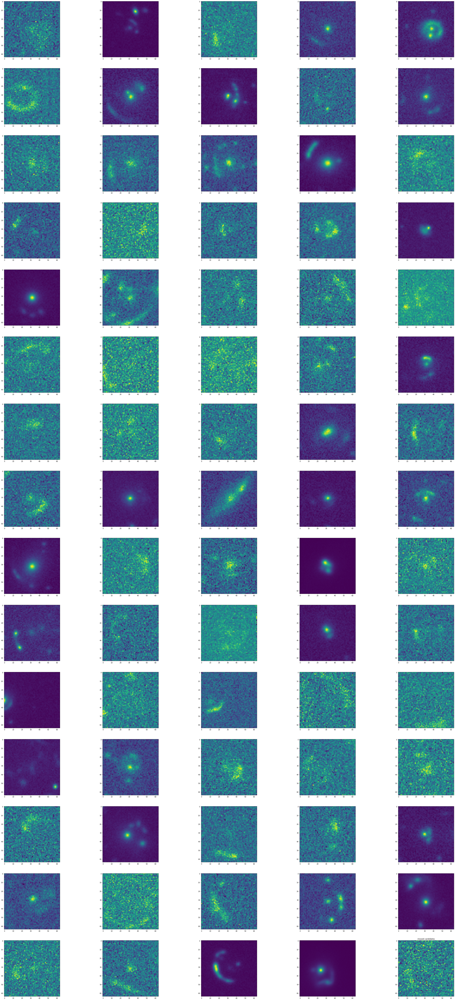

In [95]:
fig, ax = plt.subplots(15, 5, figsize=(7*8, 15*8))

for i in range(15):
    ax[i][0].imshow(arcs_array[5*i,...,0])
    ax[i][1].imshow(arcs_array[5*i+1,...,0])
    ax[i][2].imshow(arcs_array[5*i+2,...,0])
    ax[i][3].imshow(arcs_array[5*i+3,...,0])
    ax[i][4].imshow(arcs_array[5*i+4,...,0])

plt.title('missed candidates')